# Import Libraries

In [8]:
import pandas as pd
import numpy as np 

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier,plot_tree
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier

from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV
from sklearn.metrics import confusion_matrix,accuracy_score,classification_report
from sklearn.metrics import plot_confusion_matrix,plot_roc_curve

from sklearn.metrics import roc_curve,precision_score,precision_recall_curve,auc
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler,MinMaxScaler

import pickle,json
from statsmodels.stats.outliers_influence import variance_inflation_factor
from pandas.plotting import scatter_matrix
import warnings
warnings.filterwarnings('ignore')

# Data Gathering

In [9]:
df = pd.read_excel("Data.xlsx")
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,2014-06-10,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,428,...,3,0,0,0,0,0,0,3,11,0


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [11]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


In [12]:
df.tail()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,2014-06-10,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,428,...,3,0,0,0,0,0,0,3,11,0
2239,9405,1954,PhD,Married,52869.0,1,1,2012-10-15,40,84,...,7,0,0,0,0,0,0,3,11,1


# Detail Information About The Dataset

In [13]:
pip install pandas-profiling

Note: you may need to restart the kernel to use updated packages.


In [14]:
from pandas_profiling import ProfileReport

report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
#we get almost all info related to data
# missing value % ,Duplicate %,Distinct%,Duplicate rows
# univariate analysis,Bivariate analysis
# various Corr graph ,Histogram,Barplot

In [16]:
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [17]:
df_original_size = len(df)
print ("-->",df_original_size,"Observations")

--> 2240 Observations


In [18]:
def get_categorical_columns(df):
    categorical_columns = df.select_dtypes(include=['object'])
    return categorical_columns

In [19]:
cat_features = get_categorical_columns(df)
cat_features

,Education,Marital_Status,Dt_Customer
0,Graduation,Single,2012-09-04
1,Graduation,Single,2014-03-08
2,Graduation,Together,2013-08-21
3,Graduation,Together,2014-02-10
4,PhD,Married,2014-01-19
...,...,...,...
2235,Graduation,Married,2013-06-13
2236,PhD,Together,2014-06-10
2237,Graduation,Divorced,2014-01-25
2238,Master,Together,2014-01-24


# --> Graph for cat features


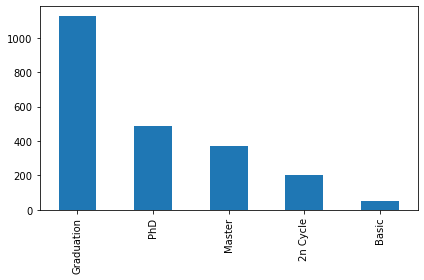

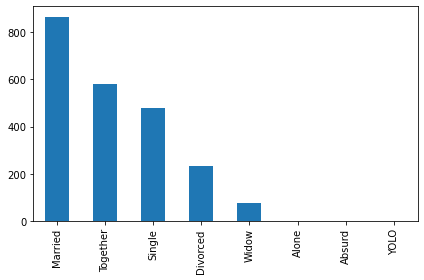

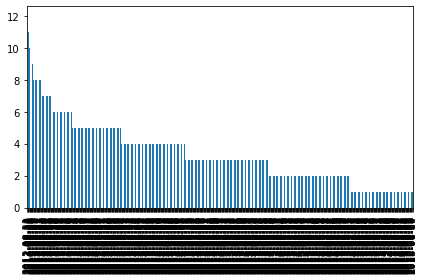

In [20]:
#barplot

for i in cat_features:
    df[i].value_counts().plot(kind='bar')
    plt.tight_layout()
    plt.show()

# >>> Graph For Continuous Features

In [21]:
# Continuous features

def get_cont_columns(df):
    cont_columns = df.select_dtypes(exclude=['object'])
    return cont_columns

In [22]:
cont_features = get_cont_columns(df)
cont_features

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,58138.0,0,0,58,635,88,546,172,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,46344.0,1,1,38,11,1,6,2,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,71613.0,0,0,26,426,49,127,111,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,26646.0,1,0,26,11,4,20,10,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,58293.0,1,0,94,173,43,118,46,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,46,709,43,182,42,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,64014.0,2,1,56,406,0,30,0,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,56981.0,0,0,91,908,48,217,32,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,69245.0,0,1,8,428,30,214,80,...,3,0,0,0,0,0,0,3,11,0


In [23]:
cont_features = ['ID', 'Year_Birth','Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response']

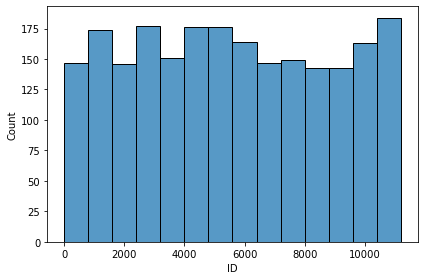

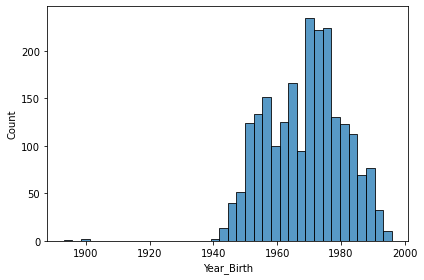

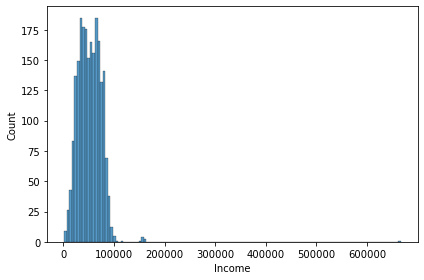

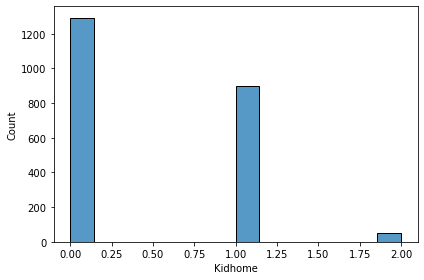

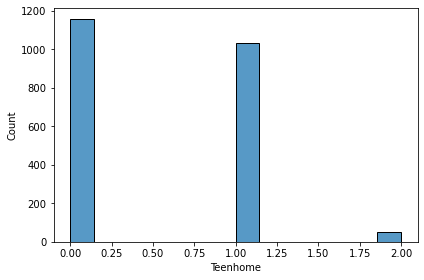

...

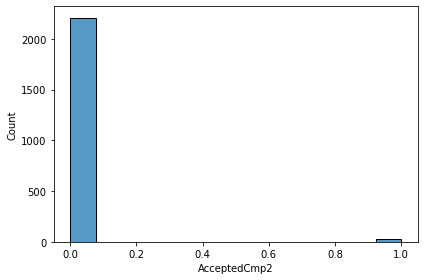

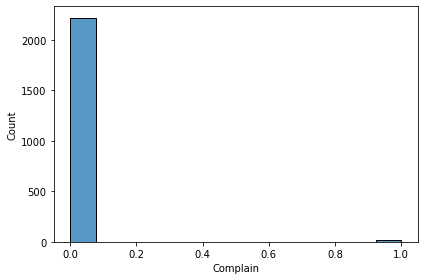

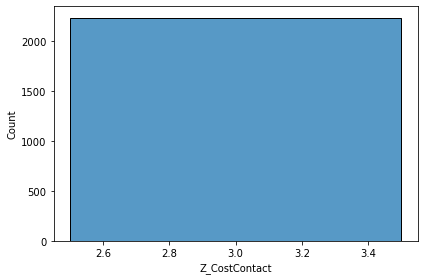

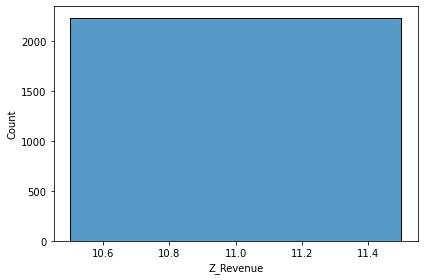

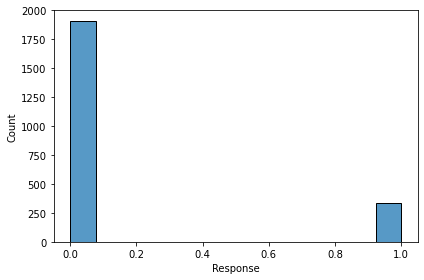

In [24]:
# histigram for continuous features
for i in cont_features:
    sns.histplot(df[i])
    plt.tight_layout()
    plt.show()

# Vizualiztize the realtion of all features in target column

<AxesSubplot:xlabel='ID', ylabel='count'>

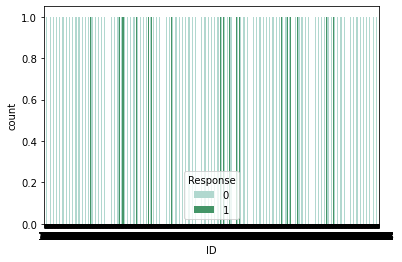

In [25]:
sns.countplot(x=df['ID'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='Year_Birth', ylabel='count'>

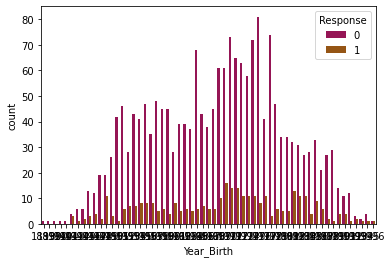

In [26]:
sns.countplot(x=df['Year_Birth'],hue=df['Response'],palette='brg')

<AxesSubplot:xlabel='Income', ylabel='count'>

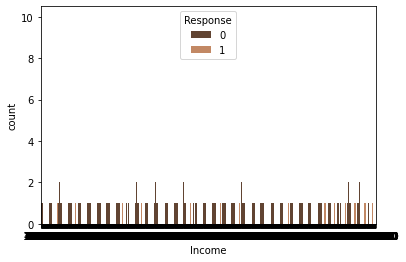

In [27]:
sns.countplot(x=df['Income'],hue=df['Response'],palette='copper')

<AxesSubplot:xlabel='Kidhome', ylabel='count'>

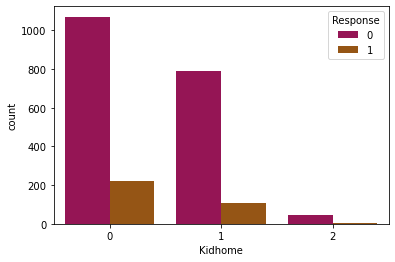

In [28]:
sns.countplot(x=df['Kidhome'],hue=df['Response'],palette='brg')

<AxesSubplot:xlabel='Teenhome', ylabel='count'>

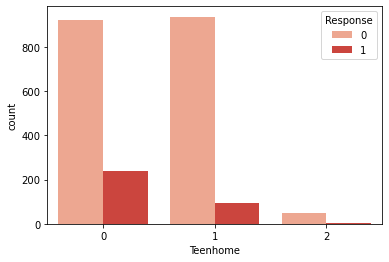

In [29]:
sns.countplot(x=df['Teenhome'],hue=df['Response'],palette='Reds')

<AxesSubplot:xlabel='Recency', ylabel='count'>

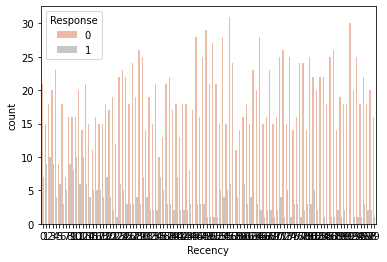

In [30]:
sns.countplot(x=df['Recency'],hue=df['Response'],palette='RdGy')

<AxesSubplot:xlabel='MntWines', ylabel='count'>

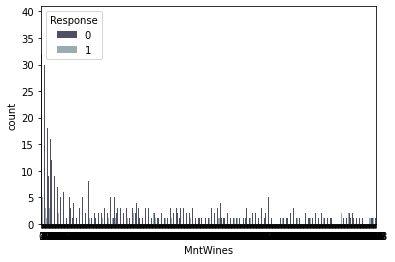

In [31]:
sns.countplot(x=df['MntWines'],hue=df['Response'],palette='bone')

<AxesSubplot:xlabel='MntFruits', ylabel='count'>

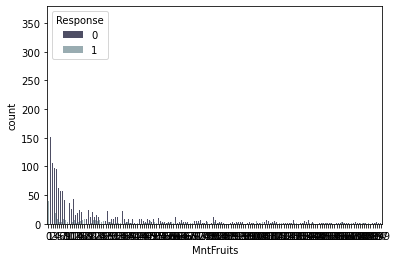

In [32]:
sns.countplot(x=df['MntFruits'],hue=df['Response'],palette='bone')

<AxesSubplot:xlabel='MntMeatProducts', ylabel='count'>

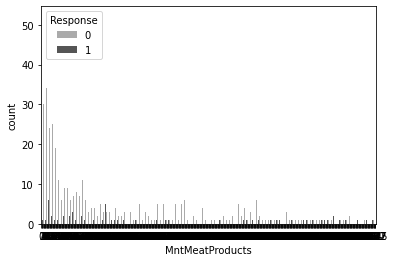

In [33]:
sns.countplot(x=df['MntMeatProducts'],hue=df['Response'],palette='binary')

<AxesSubplot:xlabel='MntFishProducts', ylabel='count'>

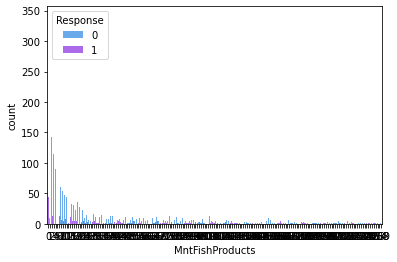

In [34]:
sns.countplot(x=df['MntFishProducts'],hue=df['Response'],palette='cool')

<AxesSubplot:xlabel='MntSweetProducts', ylabel='count'>

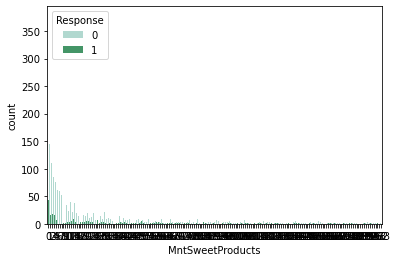

In [35]:
sns.countplot(x=df['MntSweetProducts'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='MntGoldProds', ylabel='count'>

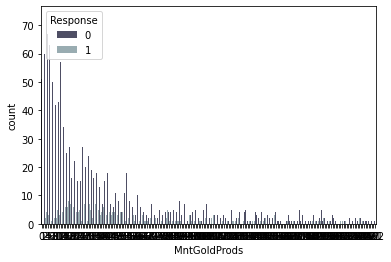

In [36]:
sns.countplot(x=df['MntGoldProds'],hue=df['Response'],palette='bone')

<AxesSubplot:xlabel='NumDealsPurchases', ylabel='count'>

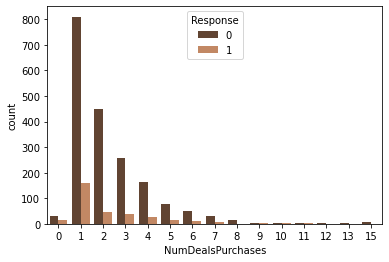

In [37]:
sns.countplot(x=df['NumDealsPurchases'],hue=df['Response'],palette='copper')

<AxesSubplot:xlabel='NumWebPurchases', ylabel='count'>

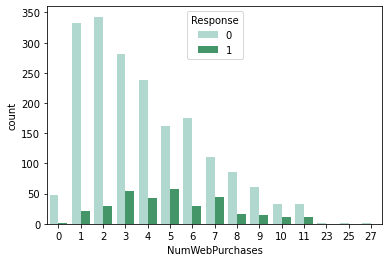

In [38]:
sns.countplot(x=df['NumWebPurchases'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='NumCatalogPurchases', ylabel='count'>

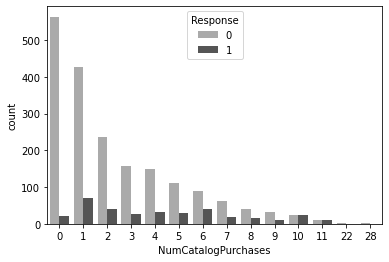

In [39]:
sns.countplot(x=df['NumCatalogPurchases'],hue=df['Response'],palette='binary')

<AxesSubplot:xlabel='NumStorePurchases', ylabel='count'>

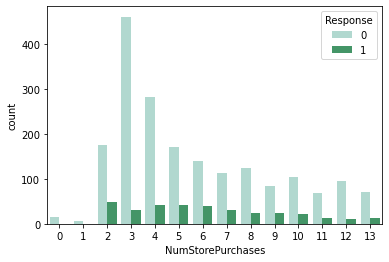

In [40]:
sns.countplot(x=df['NumStorePurchases'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='NumWebVisitsMonth', ylabel='count'>

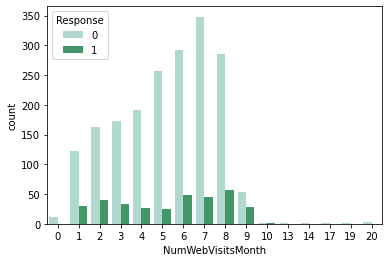

In [41]:
sns.countplot(x=df['NumWebVisitsMonth'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='AcceptedCmp3', ylabel='count'>

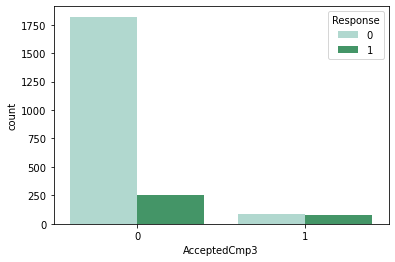

In [42]:
sns.countplot(x=df['AcceptedCmp3'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='AcceptedCmp5', ylabel='count'>

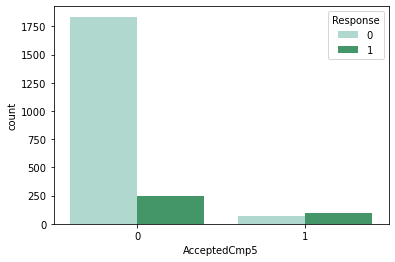

In [43]:
sns.countplot(x=df['AcceptedCmp5'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='AcceptedCmp1', ylabel='count'>

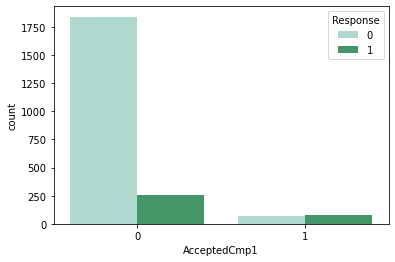

In [44]:
sns.countplot(x=df['AcceptedCmp1'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='AcceptedCmp2', ylabel='count'>

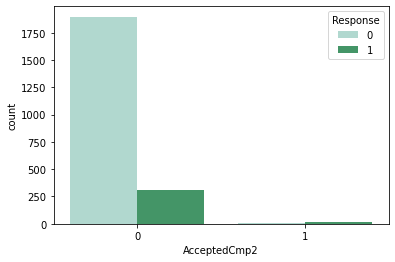

In [45]:
sns.countplot(x=df['AcceptedCmp2'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='Complain', ylabel='count'>

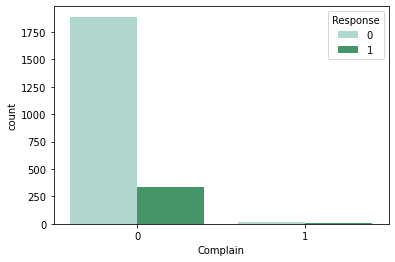

In [46]:
sns.countplot(x=df['Complain'],hue=df['Response'],palette='BuGn')

<AxesSubplot:xlabel='Z_CostContact', ylabel='count'>

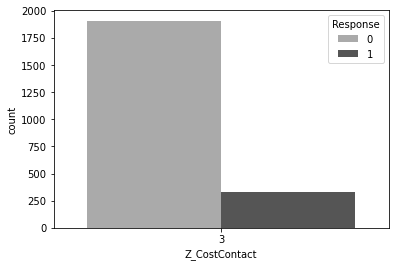

In [47]:
sns.countplot(x=df['Z_CostContact'],hue=df['Response'],palette='binary')

<AxesSubplot:xlabel='Z_Revenue', ylabel='count'>

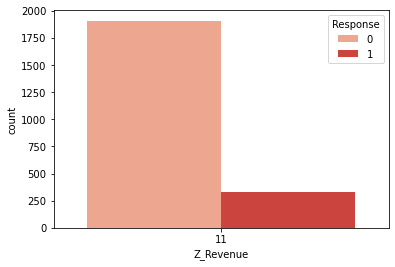

In [48]:
sns.countplot(x=df['Z_Revenue'],hue=df['Response'],palette='Reds')

# EDA

In [49]:
#df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])
#df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer']).dt.strftime('%Y-%m-%d %H:%M:%S')
#d

In [50]:
# drop column
df.drop('Dt_Customer', axis=1, inplace=True)

In [51]:
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,58,635,88,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,38,11,1,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,26,426,49,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,26,11,4,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,94,173,43,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,46,709,43,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,56,406,0,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,91,908,48,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,8,428,30,...,3,0,0,0,0,0,0,3,11,0


In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Recency              2240 non-null   int64  
 8   MntWines             2240 non-null   int64  
 9   MntFruits            2240 non-null   int64  
 10  MntMeatProducts      2240 non-null   int64  
 11  MntFishProducts      2240 non-null   int64  
 12  MntSweetProducts     2240 non-null   int64  
 13  MntGoldProds         2240 non-null   int64  
 14  NumDealsPurchases    2240 non-null   int64  
 15  NumWebPurchases      2240 non-null   i

# Missing value 

In [53]:
# checking null value if present
[i for i in df.columns if df[i].isna().sum()>0]

['Income']

In [54]:
# function that returns number of missings, percentage of missings and if it is above or below 3% threshold

def missing_values_reporter(df):    
    na_count = df.isna().sum() 
    ser = na_count[na_count > 0]
    ser_p = np.round(ser.divide(df.shape[0])*100,2)
    tmp = pd.DataFrame({"N missings": ser,"% missings": ser_p,"Above Threshold (3%)": False})
    tmp.loc[tmp["% missings"] > 3., 'Above Threshold (3%)'] = 'True' 
    return tmp

In [55]:
df_miss=missing_values_reporter(df)
df_miss

,N missings,% missings,Above Threshold (3%)
Income,24,1.07,False


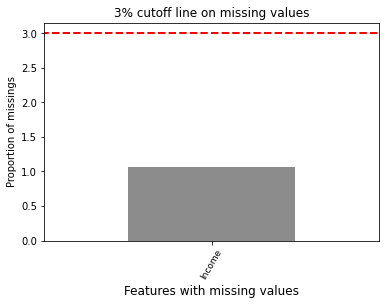

In [56]:
# cutoff is in percentage

cutoff_ = 3

cutoff_list = [cutoff_, cutoff_]
ax = df_miss.sort_values('% missings', ascending=False).plot.bar(y="% missings", 
                                                                 color="Grey",
                                                                 alpha = 0.9,
                                                                 title="{}% cutoff line on missing values".format(cutoff_),
                                                                 legend=False)
ax.set_xlabel("Features with missing values", size=12)
ax.set_ylabel("Proportion of missings")
ax.plot([-1, len(df_miss.index)], cutoff_list,'r--', lw=2)
ax.set_xticklabels(df_miss.index, rotation=60, size=9)
plt.show()

In [57]:
df['Income'].mean()

52247.25135379061

In [58]:
# immputing missing value by mean

df['Income'].fillna(df['Income'].mean(),inplace=True)

In [59]:
[i for i in df.columns if df[i].isna().sum()>0]

[]

# Outlier Detection

<AxesSubplot:>

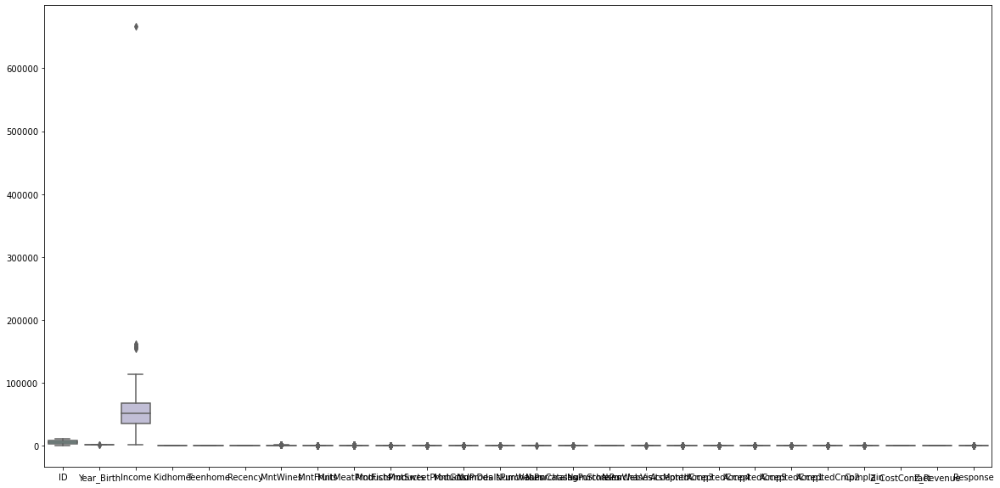

In [60]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df,color='bone',palette="Set3")

<AxesSubplot:xlabel='Income'>

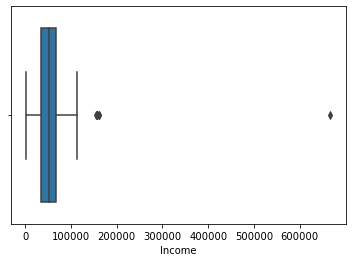

In [61]:
sns.boxplot(df['Income'])

In [62]:
# most of these outlier present in Income

In [63]:
q1=df['Income'].describe()[4]     #25%    #df['fn'].quintile(0.25)
q3=df['Income'].describe()[6]      #75%
iqr=q3-q1

lower_tail=q1-1.5*iqr     # upper tail q3+1.5(iqr)      
print()
print('q1==',q1)
print('q3==',q3)
print()
print('iqr==',iqr)
print()
print('lower_tail==',lower_tail)


q1== 35538.75
q3== 68289.75

iqr== 32751.0

lower_tail== -13587.75


In [64]:
df.loc[df['Income']<lower_tail,'Income']=np.nan # imputing outlier with nan

In [65]:
np.where(df['Income']<lower_tail)  # so succesfully imputed with outlier 

(array([], dtype=int64),)

In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2240 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Recency              2240 non-null   int64  
 8   MntWines             2240 non-null   int64  
 9   MntFruits            2240 non-null   int64  
 10  MntMeatProducts      2240 non-null   int64  
 11  MntFishProducts      2240 non-null   int64  
 12  MntSweetProducts     2240 non-null   int64  
 13  MntGoldProds         2240 non-null   int64  
 14  NumDealsPurchases    2240 non-null   int64  
 15  NumWebPurchases      2240 non-null   i

# One Hot Encoding

In [67]:
df=pd.get_dummies(df,columns=['Marital_Status','Education'],drop_first= True)

In [68]:
df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,5524,1957,58138.0,0,0,58,635,88,546,172,...,0,0,1,0,0,0,0,1,0,0
1,2174,1954,46344.0,1,1,38,11,1,6,2,...,0,0,1,0,0,0,0,1,0,0
2,4141,1965,71613.0,0,0,26,426,49,127,111,...,0,0,0,1,0,0,0,1,0,0
3,6182,1984,26646.0,1,0,26,11,4,20,10,...,0,0,0,1,0,0,0,1,0,0
4,5324,1981,58293.0,1,0,94,173,43,118,46,...,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,46,709,43,182,42,...,0,1,0,0,0,0,0,1,0,0
2236,4001,1946,64014.0,2,1,56,406,0,30,0,...,0,0,0,1,0,0,0,0,0,1
2237,7270,1981,56981.0,0,0,91,908,48,217,32,...,1,0,0,0,0,0,0,1,0,0
2238,8235,1956,69245.0,0,1,8,428,30,214,80,...,0,0,0,1,0,0,0,0,1,0


In [69]:
df1=df.copy()

# Standardization

In [70]:
#Standardization
x=df.drop('Response',axis=1)
y=df['Response']

std=StandardScaler()
arr=std.fit_transform(x)
std_df=pd.DataFrame(arr,columns=x.columns)
std_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,-0.020999,-0.985345,0.235327,-0.825218,-0.929894,0.307039,0.983781,1.551577,1.679702,2.462147,...,-0.339909,-0.792406,1.914854,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
1,-1.053058,-1.235733,-0.235826,1.032559,0.906934,-0.383664,-0.870479,-0.636301,-0.713225,-0.650449,...,-0.339909,-0.792406,1.914854,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2,-0.447070,-0.317643,0.773633,-0.825218,-0.929894,-0.798086,0.362723,0.570804,-0.177032,1.345274,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
3,0.181716,1.268149,-1.022732,1.032559,-0.929894,-0.798086,-0.870479,-0.560857,-0.651187,-0.503974,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
4,-0.082614,1.017761,0.241519,1.032559,-0.929894,1.550305,-0.389085,0.419916,-0.216914,0.155164,...,-0.339909,1.261980,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,-1.006270,-0.444816,1.899751
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1.625983,-0.150717,0.358568,-0.825218,0.906934,-0.107383,1.203678,0.419916,0.066692,0.081926,...,-0.339909,1.261980,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2236,-0.490200,-1.903435,0.470064,2.890335,0.906934,0.237969,0.303291,-0.661449,-0.606873,-0.687068,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,-1.006270,-0.444816,1.899751
2237,0.516905,1.017761,0.189106,-0.825218,-0.929894,1.446700,1.795020,0.545656,0.221789,-0.101168,...,2.941967,-0.792406,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2238,0.814199,-1.068807,0.679035,-0.825218,0.906934,-1.419719,0.368666,0.092992,0.208495,0.777683,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,-1.006270,2.248122,-0.526385


# Normalization

In [71]:
norm=MinMaxScaler()
arr=norm.fit_transform(x)
norm_df=pd.DataFrame(arr,columns=x.columns)
norm_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,0.493611,0.621359,0.084832,0.0,0.0,0.585859,0.425318,0.442211,0.316522,0.664093,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.194263,0.592233,0.067095,0.5,0.5,0.383838,0.007368,0.005025,0.003478,0.007722,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.370029,0.699029,0.105097,0.0,0.0,0.262626,0.285332,0.246231,0.073623,0.428571,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.552408,0.883495,0.037471,0.5,0.0,0.262626,0.007368,0.020101,0.011594,0.038610,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.475739,0.854369,0.085065,0.5,0.0,0.949495,0.115874,0.216080,0.068406,0.177606,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,0.971316,0.718447,0.089472,0.0,0.5,0.464646,0.474883,0.216080,0.105507,0.162162,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2236,0.357519,0.514563,0.093669,1.0,0.5,0.565657,0.271936,0.000000,0.017391,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2237,0.649629,0.854369,0.083092,0.0,0.0,0.919192,0.608171,0.241206,0.125797,0.123552,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2238,0.735859,0.611650,0.101536,0.0,0.5,0.080808,0.286671,0.150754,0.124058,0.308880,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


# Transformation

In [72]:
log_tf_df=np.log(df)
log_tf_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,8.616858,7.579168,10.970575,-inf,-inf,4.060443,6.453625,4.477337,6.302619,5.147494,...,-inf,-inf,0.0,-inf,-inf,-inf,-inf,0.0,-inf,-inf
1,7.684324,7.577634,10.743847,0.000000,0.0,3.637586,2.397895,0.000000,1.791759,0.693147,...,-inf,-inf,0.0,-inf,-inf,-inf,-inf,0.0,-inf,-inf
2,8.328693,7.583248,11.179032,-inf,-inf,3.258097,6.054439,3.891820,4.844187,4.709530,...,-inf,-inf,-inf,0.0,-inf,-inf,-inf,0.0,-inf,-inf
3,8.729397,7.592870,10.190394,0.000000,-inf,3.258097,2.397895,1.386294,2.995732,2.302585,...,-inf,-inf,-inf,0.0,-inf,-inf,-inf,0.0,-inf,-inf
4,8.579980,7.591357,10.973237,0.000000,-inf,4.543295,5.153292,3.761200,4.770685,3.828641,...,-inf,0.0,-inf,-inf,-inf,-inf,-inf,-inf,-inf,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,9.293762,7.584265,11.022278,-inf,0.0,3.828641,6.563856,3.761200,5.204007,3.737670,...,-inf,0.0,-inf,-inf,-inf,-inf,-inf,0.0,-inf,-inf
2236,8.294300,7.573531,11.066857,0.693147,0.0,4.025352,6.006353,-inf,3.401197,-inf,...,-inf,-inf,-inf,0.0,-inf,-inf,-inf,-inf,-inf,0.0
2237,8.891512,7.591357,10.950473,-inf,-inf,4.510860,6.811244,3.871201,5.379897,3.465736,...,0.0,-inf,-inf,-inf,-inf,-inf,-inf,0.0,-inf,-inf
2238,9.016149,7.578657,11.145406,-inf,0.0,2.079442,6.059123,3.401197,5.365976,4.382027,...,-inf,-inf,-inf,0.0,-inf,-inf,-inf,-inf,0.0,-inf


In [73]:
sqrt_tf_df=np.sqrt(df)
sqrt_tf_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,74.323617,44.237993,241.118228,0.000000,0.0,7.615773,25.199206,9.380832,23.366643,13.114877,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,46.626173,44.204072,215.276566,1.000000,1.0,6.164414,3.316625,1.000000,2.449490,1.414214,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,64.350602,44.328321,267.606054,0.000000,0.0,5.099020,20.639767,7.000000,11.269428,10.535654,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,78.625696,44.542115,163.236025,1.000000,0.0,5.099020,3.316625,2.000000,4.472136,3.162278,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,72.965745,44.508426,241.439433,1.000000,0.0,9.695360,13.152946,6.557439,10.862780,6.782330,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,104.259292,44.350874,247.432819,0.000000,1.0,6.782330,26.627054,6.557439,13.490738,6.480741,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2236,63.253458,44.113490,253.009881,1.414214,1.0,7.483315,20.149442,0.000000,5.477226,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2237,85.264295,44.508426,238.706933,0.000000,0.0,9.539392,30.133038,6.928203,14.730920,5.656854,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2238,90.746901,44.226689,263.144447,0.000000,1.0,2.828427,20.688161,5.477226,14.628739,8.944272,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [74]:
cbrt_tf_df=np.cbrt(df)
cbrt_tf_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,17.677380,12.508261,38.739442,0.000000,0.0,3.870877,8.595238,4.447960,8.173302,5.561298,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,12.954476,12.501866,35.919574,1.000000,1.0,3.361975,2.223980,1.000000,1.817121,1.259921,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,16.058380,12.525282,41.527006,0.000000,0.0,2.962496,7.524365,3.659306,5.026526,4.805896,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,18.353110,12.565523,29.868312,1.000000,0.0,2.962496,2.223980,1.587401,2.714418,2.154435,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,17.461412,12.559186,38.773839,1.000000,0.0,4.546836,5.572055,3.503398,4.904868,3.583048,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,22.151842,12.529530,39.412883,0.000000,1.0,3.583048,8.916931,3.503398,5.667051,3.476027,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2236,15.875333,12.484781,40.002916,1.259921,1.0,3.825862,7.404721,0.000000,3.107233,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2237,19.372164,12.559186,38.480735,0.000000,0.0,4.497941,9.683417,3.634241,6.009245,3.174802,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2238,20.193946,12.506130,41.064147,0.000000,1.0,2.000000,7.536122,3.107233,5.981424,4.308869,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


# Feature Selection

In [75]:
df.corr()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
ID,1.000000,0.000028,0.013036,0.002406,-0.002580,-0.046524,-0.022878,0.004600,-0.004437,-0.024475,...,-0.017289,0.010007,-0.016558,0.009563,0.021937,0.002029,-0.009478,0.018713,-0.025833,0.004368
Year_Birth,0.000028,1.000000,-0.160942,0.230176,-0.352111,-0.019871,-0.157773,-0.017917,-0.030872,-0.041625,...,-0.071774,0.051193,0.116978,-0.052258,-0.161370,0.010465,0.113564,0.069667,-0.071557,-0.121370
Income,0.013036,-0.160942,1.000000,-0.425176,0.019018,-0.003946,0.576789,0.428747,0.577802,0.437497,...,0.007970,-0.016399,-0.025628,0.023288,0.031501,-0.004556,-0.200549,0.018833,0.011750,0.081126
Kidhome,0.002406,0.230176,-0.425176,1.000000,-0.036133,0.008827,-0.496297,-0.372581,-0.437129,-0.387644,...,-0.019199,0.017403,0.019779,0.006373,-0.073760,-0.024669,0.054144,0.000648,0.008146,-0.042013
Teenhome,-0.002580,-0.352111,0.019018,-0.036133,1.000000,0.016198,0.004846,-0.176764,-0.261160,-0.204187,...,0.052613,0.007749,-0.095925,0.025038,0.045093,0.027112,-0.119421,-0.022213,0.023601,0.089451
Recency,-0.046524,-0.019871,-0.003946,0.008827,0.016198,1.000000,0.016064,-0.004306,0.023056,0.001079,...,0.004434,-0.022757,0.007158,0.020363,0.000218,-0.047603,-0.003609,0.032184,-0.023394,-0.011377
MntWines,-0.022878,-0.157773,0.576789,-0.496297,0.004846,0.016064,1.000000,0.389637,0.562667,0.399753,...,0.021120,-0.010491,-0.024216,0.005077,0.036632,0.001605,-0.138570,-0.058808,0.038517,0.157295
MntFruits,0.004600,-0.017917,0.428747,-0.372581,-0.176764,-0.004306,0.389637,1.000000,0.543105,0.594804,...,0.009612,-0.011304,0.007002,-0.014155,0.032211,-0.017518,-0.060043,0.113177,-0.051996,-0.082772
MntMeatProducts,-0.004437,-0.030872,0.577802,-0.437129,-0.261160,0.023056,0.562667,0.543105,1.000000,0.568402,...,-0.025219,-0.022011,0.035079,0.003021,0.018675,-0.015492,-0.108306,0.055913,-0.007040,0.003855
MntFishProducts,-0.024475,-0.041625,0.437497,-0.387644,-0.204187,0.001079,0.399753,0.594804,0.568402,1.000000,...,-0.015449,-0.031116,0.006609,0.015865,0.047894,-0.018350,-0.058906,0.103627,-0.044186,-0.104060


<AxesSubplot:>

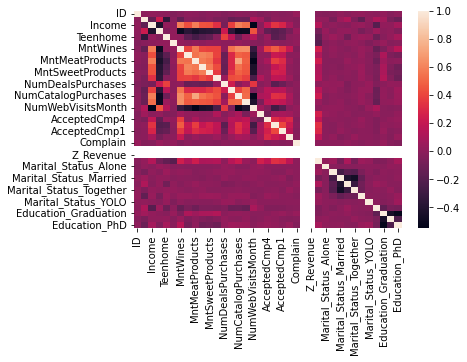

In [76]:
sns.heatmap(df.corr())

# Spearman Method

<AxesSubplot:>

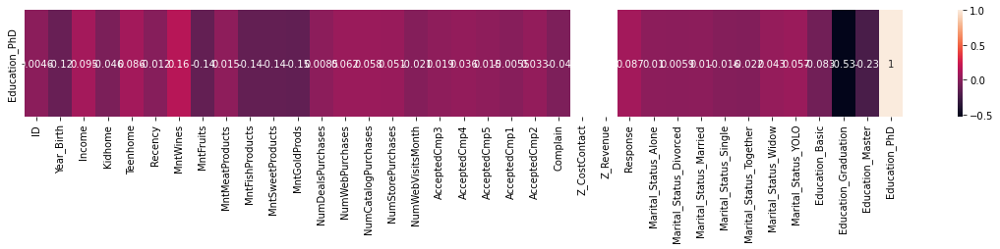

In [77]:
corr=df.corr(method='spearman').tail(1)
plt.figure(figsize=(20,2))
sns.heatmap(corr,annot=True)

# Kendall

<AxesSubplot:>

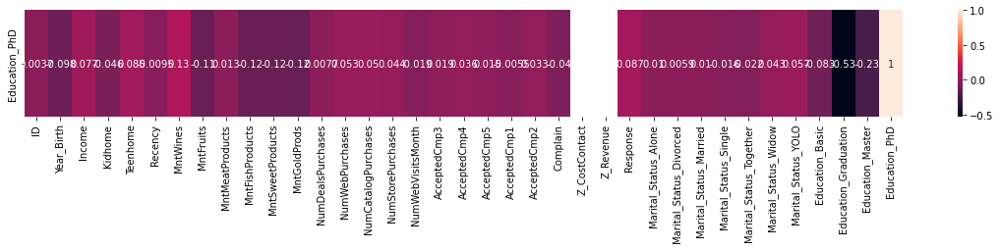

In [78]:
corr=df.corr(method='kendall').tail(1)
plt.figure(figsize=(20,2))
sns.heatmap(corr,annot=True)

# Pearson Method

<AxesSubplot:>

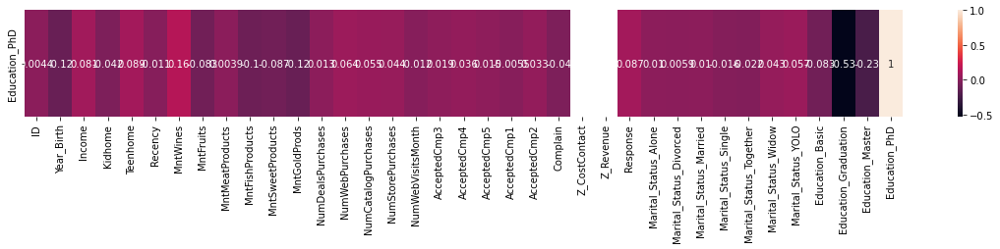

In [79]:
corr=df.corr(method='pearson').tail(1)
plt.figure(figsize=(20,2))
sns.heatmap(corr,annot=True)

# missing value ratio

In [80]:
df.isna().mean()*100

ID                         0.0
Year_Birth                 0.0
Income                     0.0
Kidhome                    0.0
Teenhome                   0.0
Recency                    0.0
MntWines                   0.0
MntFruits                  0.0
MntMeatProducts            0.0
MntFishProducts            0.0
MntSweetProducts           0.0
MntGoldProds               0.0
NumDealsPurchases          0.0
NumWebPurchases            0.0
NumCatalogPurchases        0.0
NumStorePurchases          0.0
NumWebVisitsMonth          0.0
AcceptedCmp3               0.0
AcceptedCmp4               0.0
AcceptedCmp5               0.0
AcceptedCmp1               0.0
AcceptedCmp2               0.0
Complain                   0.0
Z_CostContact              0.0
Z_Revenue                  0.0
Response                   0.0
Marital_Status_Alone       0.0
Marital_Status_Divorced    0.0
Marital_Status_Married     0.0
Marital_Status_Single      0.0
Marital_Status_Together    0.0
Marital_Status_Widow       0.0
Marital_

# varience threshold method

In [81]:
#var_th = VarianceThreshold(threshold=0.5)
#var_th.fit_transform(x)
#var_th.get_support()

In [82]:
#np.where(var_th.get_support()==False)

# Anova Test

In [83]:
#from sklearn.feature_selection import f_classif

In [84]:
#f_val,p_val=f_classif(df)
#df=pd.DataFrame({'f_val':f_val,'p_Val':np.around(p_val,5)},index=x.columns)
#df.sort_values('f_val')

# Forward Feature Selection Method

In [85]:
#from sklearn.feature_selection import SequentialFeatureSelector
#from sklearn.neighbors import KNeighborsClassifier

#knn_model=KNeighborsClassifier()

#sfs=SequentialFeatureSelector(knn_model,n_features_to_select=6,direction='forward',cv=5,n_jobs=-1)
#sfs.fit(df)
#arr2=sfs.get_support()
#s3=pd.Series(arr2,index=df.columns)
#s3

# Bidirectional

In [86]:
#pip install mlxtend

In [87]:
#from mlxtend.feature_selection import SequentialFeatureSelector  

#from sklearn.neighbors import KNeighborsClassifier

#knn_model=KNeighborsClassifier()

#sfs=SequentialFeatureSelector(knn_model,k_features=5,floating=True,cv=5,n_jobs=-1)
#sfs.fit(x,y)
#pd.DataFrame(sfs.subsets_).T

# Model Building

In [88]:
# train test split

x_train,x_test,y_train,y_test=train_test_split(df.drop(columns=['Response']),df['Response'],test_size=0.20,random_state=42)

In [89]:
x_train

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
792,3479,1950,16813.0,0,0,49,4,8,11,12,...,0,0,1,0,0,0,0,1,0,0
1271,7488,1963,64191.0,0,1,30,420,15,186,151,...,0,0,1,0,0,0,0,0,1,0
1538,1079,1971,71969.0,0,1,59,1000,0,76,0,...,0,1,0,0,0,0,0,0,0,1
668,11007,1968,29187.0,1,0,43,26,0,6,0,...,0,1,0,0,0,0,0,0,0,1
1975,10311,1969,4428.0,0,1,0,16,4,12,2,...,0,1,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1638,10785,1969,44078.0,1,1,17,24,1,10,2,...,0,1,0,0,0,0,0,1,0,0
1095,9964,1979,61825.0,0,1,56,162,50,100,55,...,0,0,1,0,0,0,0,1,0,0
1130,3412,1951,67381.0,0,1,67,815,8,53,11,...,0,1,0,0,0,0,0,0,1,0
1294,2811,1963,48918.0,1,1,21,52,0,9,0,...,0,0,1,0,0,0,0,0,0,1


In [90]:
x_test

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
324,2607,1953,40464.0,0,1,78,424,17,118,7,...,0,0,1,0,0,0,0,1,0,0
96,7247,1960,47916.0,0,1,72,505,0,26,0,...,0,0,0,0,1,0,0,1,0,0
2104,5802,1972,14188.0,0,0,40,2,7,11,16,...,0,1,0,0,0,0,1,0,0,0
1259,2147,1969,76653.0,0,0,91,736,63,946,219,...,0,0,0,1,0,0,0,1,0,0
1061,3759,1958,65196.0,0,2,34,743,19,181,12,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
423,1361,1974,82584.0,0,0,26,1076,68,103,29,...,0,1,0,0,0,0,0,0,1,0
1340,9386,1962,50127.0,0,1,88,274,0,21,4,...,0,0,0,1,0,0,0,1,0,0
755,3870,1978,63855.0,0,0,28,359,35,314,93,...,0,0,0,1,0,0,0,0,0,0
2138,2948,1954,62637.0,0,1,76,104,12,48,4,...,1,0,0,0,0,0,0,0,1,0


In [91]:
y_train

792     0
1271    0
1538    0
668     0
1975    0
       ..
1638    0
1095    0
1130    0
1294    0
860     0
Name: Response, Length: 1792, dtype: int64

In [92]:
y_test

324     0
96      0
2104    0
1259    0
1061    0
       ..
423     1
1340    0
755     0
2138    0
618     0
Name: Response, Length: 448, dtype: int64

# Logistic Regression

In [93]:
log_reg=LogisticRegression()

log_reg.fit(x_train,y_train)

LogisticRegression()

In [94]:
# slope (m)
log_reg.intercept_

array([-1.01490497e-06])

In [95]:
# coeficient (c)
log_reg.coef_

array([[-2.65177877e-05, -4.74527010e-04, -1.61643264e-05,
         9.20024213e-05, -2.71356653e-04, -2.47983642e-02,
         1.72194284e-03, -6.67872948e-04,  2.51344057e-03,
        -3.60705923e-03,  8.17149470e-04,  4.53720194e-03,
         1.21507024e-04,  6.45181195e-04,  4.85873424e-04,
        -1.48363320e-03,  1.08121388e-03,  3.23470848e-04,
         1.43563205e-04,  2.68400631e-04,  2.57936251e-04,
         6.02323648e-05,  6.81903874e-06, -3.04470145e-06,
        -1.11639053e-05,  5.44935105e-06,  8.03703890e-05,
        -1.66322801e-04,  1.86385305e-04, -1.77770759e-04,
         5.82358137e-05,  5.76023080e-06, -1.72342644e-05,
        -7.97885190e-05, -1.25711626e-05,  1.42636740e-04]])

<AxesSubplot:>

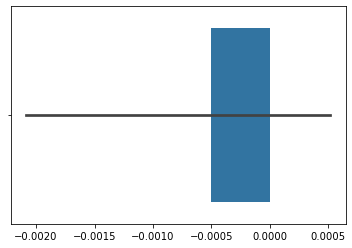

In [96]:
series=pd.Series(log_reg.coef_[0])
sns.barplot(series)

In [97]:
# performance matrix on training data

y_pred_train=log_reg.predict(x_train)

prec=precision_score(y_train,y_pred_train)
print('precision score is',prec)
print("*"*60)
acc_score_train=accuracy_score(y_train,y_pred_train)
print('accuracy score is',acc_score_train)
print("*"*60)
conf=confusion_matrix(y_train,y_pred_train)
print('confusion matrix',conf)
print("*"*60)
cls_report=classification_report(y_train,y_pred_train)
print('classification report',cls_report)

precision score is 0.5454545454545454
************************************************************
accuracy score is 0.8560267857142857
************************************************************
confusion matrix [[1492   35]
 [ 223   42]]
************************************************************
classification report               precision    recall  f1-score   support

           0       0.87      0.98      0.92      1527
           1       0.55      0.16      0.25       265

    accuracy                           0.86      1792
   macro avg       0.71      0.57      0.58      1792
weighted avg       0.82      0.86      0.82      1792



In [98]:
# testing
y_pred_test=log_reg.predict(x_test)

prec=precision_score(y_test,y_pred_test)
print('precision score is',prec)
print("*"*60)
acc_score_test=accuracy_score(y_test,y_pred_test)
print('accuracy score is',acc_score_test)
print("*"*60)
conf=confusion_matrix(y_test,y_pred_test)
print('confusion matrix',conf)
print("*"*60)
cls_report=classification_report(y_test,y_pred_test)
print('classification report',cls_report)

precision score is 0.47058823529411764
************************************************************
accuracy score is 0.84375
************************************************************
confusion matrix [[370   9]
 [ 61   8]]
************************************************************
classification report               precision    recall  f1-score   support

           0       0.86      0.98      0.91       379
           1       0.47      0.12      0.19        69

    accuracy                           0.84       448
   macro avg       0.66      0.55      0.55       448
weighted avg       0.80      0.84      0.80       448



In [99]:
# creating for record of all accuracy
result_dict = {'accuracy_train':[],'accuracy_test': []}
index = []

Text(0, 0.5, 'TPR')

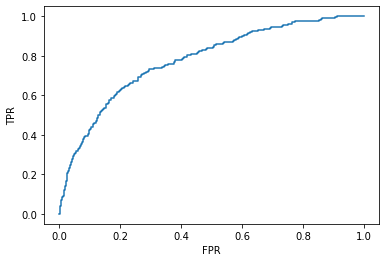

In [100]:
y_pred_proba = log_reg.predict_proba(x_train)
fpr,tpr,thresh = roc_curve(y_train,y_pred_proba[:,1])
plt.plot(fpr,tpr)
plt.xlabel('FPR')
plt.ylabel('TPR')

In [101]:
area = auc(fpr,tpr)
print('Area Under ROC Curve',area)

Area Under ROC Curve 0.778324745771089


In [102]:
# higher auc curve indicate good model

In [103]:
result_dict['accuracy_train'].append(acc_score_train)
result_dict['accuracy_test'].append(acc_score_test)
index.append('logistic_reg')

In [104]:
# try with log reg with over sampling

In [105]:
from imblearn.over_sampling import SMOTE,RandomOverSampler

In [106]:
# oversampling with smote

x=df.drop('Response',axis=1)
y=df['Response']

smt=RandomOverSampler()

x_new,y_new=smt.fit_resample(x,y)
x_train,x_test,y_train,y_test=train_test_split(x_new,y_new,test_size=0.2,random_state=12)

In [107]:
## log reg with smote model

In [108]:
log_model_over = LogisticRegression()
log_model_over.fit(x_train,y_train)

LogisticRegression()

In [109]:
## testing data evalution

In [110]:
y_pred=log_model_over.predict(x_test)

con_mat=confusion_matrix(y_test,y_pred)
print('Confusion Matrix: \n',con_mat)
print('#'*60)
acc_test=accuracy_score(y_test,y_pred)
print('Accuracy: \n', acc_test)
print('#'*60)
clf_report=classification_report(y_test,y_pred)
print('Classification Report: \n',clf_report)

Confusion Matrix: 
 [[286  98]
 [113 266]]
############################################################
Accuracy: 
 0.7234600262123198
############################################################
Classification Report: 
               precision    recall  f1-score   support

           0       0.72      0.74      0.73       384
           1       0.73      0.70      0.72       379

    accuracy                           0.72       763
   macro avg       0.72      0.72      0.72       763
weighted avg       0.72      0.72      0.72       763



In [111]:
# training
y_pred_train=log_model_over.predict(x_train)

con_mat=confusion_matrix(y_train,y_pred_train)
print('Confusion Matrix: \n',con_mat)
print('#'*60)
acc_train=accuracy_score(y_train,y_pred_train)
print('Accuracy: \n', acc_train)
print('#'*60)
clf_report=classification_report(y_train,y_pred_train)
print('Classification Report: \n',clf_report)

Confusion Matrix: 
 [[1073  449]
 [ 457 1070]]
############################################################
Accuracy: 
 0.702853394555592
############################################################
Classification Report: 
               precision    recall  f1-score   support

           0       0.70      0.70      0.70      1522
           1       0.70      0.70      0.70      1527

    accuracy                           0.70      3049
   macro avg       0.70      0.70      0.70      3049
weighted avg       0.70      0.70      0.70      3049



In [112]:
result_dict['accuracy_test'].append(acc_test)
result_dict['accuracy_train'].append(acc_train)
index.append('logistic_after_oversampling')

# KNN

In [113]:
knn_model = KNeighborsClassifier()
knn_model.fit(x_train,y_train)

KNeighborsClassifier()

In [114]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=12,stratify=y)
normal_scaler=MinMaxScaler()
array=normal_scaler.fit_transform(x)
x_nor_df=pd.DataFrame(array,columns=x.columns)
x_nor_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,0.493611,0.621359,0.084832,0.0,0.0,0.585859,0.425318,0.442211,0.316522,0.664093,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.194263,0.592233,0.067095,0.5,0.5,0.383838,0.007368,0.005025,0.003478,0.007722,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.370029,0.699029,0.105097,0.0,0.0,0.262626,0.285332,0.246231,0.073623,0.428571,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.552408,0.883495,0.037471,0.5,0.0,0.262626,0.007368,0.020101,0.011594,0.038610,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.475739,0.854369,0.085065,0.5,0.0,0.949495,0.115874,0.216080,0.068406,0.177606,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,0.971316,0.718447,0.089472,0.0,0.5,0.464646,0.474883,0.216080,0.105507,0.162162,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2236,0.357519,0.514563,0.093669,1.0,0.5,0.565657,0.271936,0.000000,0.017391,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2237,0.649629,0.854369,0.083092,0.0,0.0,0.919192,0.608171,0.241206,0.125797,0.123552,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2238,0.735859,0.611650,0.101536,0.0,0.5,0.080808,0.286671,0.150754,0.124058,0.308880,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [115]:
standard_scaler=StandardScaler()
array=standard_scaler.fit_transform(x)
x_std_df=pd.DataFrame(array,columns=x.columns)
x_std_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Divorced,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,-0.020999,-0.985345,0.235327,-0.825218,-0.929894,0.307039,0.983781,1.551577,1.679702,2.462147,...,-0.339909,-0.792406,1.914854,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
1,-1.053058,-1.235733,-0.235826,1.032559,0.906934,-0.383664,-0.870479,-0.636301,-0.713225,-0.650449,...,-0.339909,-0.792406,1.914854,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2,-0.447070,-0.317643,0.773633,-0.825218,-0.929894,-0.798086,0.362723,0.570804,-0.177032,1.345274,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
3,0.181716,1.268149,-1.022732,1.032559,-0.929894,-0.798086,-0.870479,-0.560857,-0.651187,-0.503974,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
4,-0.082614,1.017761,0.241519,1.032559,-0.929894,1.550305,-0.389085,0.419916,-0.216914,0.155164,...,-0.339909,1.261980,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,-1.006270,-0.444816,1.899751
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1.625983,-0.150717,0.358568,-0.825218,0.906934,-0.107383,1.203678,0.419916,0.066692,0.081926,...,-0.339909,1.261980,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2236,-0.490200,-1.903435,0.470064,2.890335,0.906934,0.237969,0.303291,-0.661449,-0.606873,-0.687068,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,-1.006270,-0.444816,1.899751
2237,0.516905,1.017761,0.189106,-0.825218,-0.929894,1.446700,1.795020,0.545656,0.221789,-0.101168,...,2.941967,-0.792406,-0.522233,-0.591099,-0.188676,-0.029894,-0.157171,0.993769,-0.444816,-0.526385
2238,0.814199,-1.068807,0.679035,-0.825218,0.906934,-1.419719,0.368666,0.092992,0.208495,0.777683,...,-0.339909,-0.792406,-0.522233,1.691765,-0.188676,-0.029894,-0.157171,-1.006270,2.248122,-0.526385


In [116]:
# Testing
y_pred = knn_model.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[286  95]
 [  5  62]]
************************************************************
 Accuracy : 0.7767857142857143
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.98      0.75      0.85       381
           1       0.39      0.93      0.55        67

    accuracy                           0.78       448
   macro avg       0.69      0.84      0.70       448
weighted avg       0.89      0.78      0.81       448



In [117]:
# Training
y_pred_train = knn_model.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)
print("*"*60)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)


Confusion Matrix :
 [[1150  375]
 [  17  250]]
************************************************************
 Accuracy : 0.78125
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.99      0.75      0.85      1525
           1       0.40      0.94      0.56       267

    accuracy                           0.78      1792
   macro avg       0.69      0.85      0.71      1792
weighted avg       0.90      0.78      0.81      1792



In [118]:
# KNN Classifier Normal
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append('KNN_Model_Normalization')

In [119]:
#Hyperparameter Tuning
knn_clf=KNeighborsClassifier()
hyperparameters={'n_neighbors':np.arange(1,50),'p':[1,2,3]}
gscv_knn_clf = GridSearchCV(knn_clf,hyperparameters,cv=5)
gscv_knn_clf.fit(x_train, y_train)
gscv_knn_clf.best_estimator_

KNeighborsClassifier(n_neighbors=37)

In [120]:
# Testing
knn_model_hyp = gscv_knn_clf.best_estimator_
y_pred = knn_model_hyp.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[372   9]
 [ 65   2]]
 Accuracy : 0.8348214285714286
Classication Report : 
               precision    recall  f1-score   support

           0       0.85      0.98      0.91       381
           1       0.18      0.03      0.05        67

    accuracy                           0.83       448
   macro avg       0.52      0.50      0.48       448
weighted avg       0.75      0.83      0.78       448



In [121]:
# Training
knn_model_hyp = gscv_knn_clf.best_estimator_
y_pred_train = knn_model_hyp.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1504   21]
 [ 236   31]]
 Accuracy : 0.8565848214285714
Classication Report : 
               precision    recall  f1-score   support

           0       0.86      0.99      0.92      1525
           1       0.60      0.12      0.19       267

    accuracy                           0.86      1792
   macro avg       0.73      0.55      0.56      1792
weighted avg       0.82      0.86      0.81      1792



In [122]:
# KNN Classifier Normal After Hyper
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append('KNN_Model_Normal_with_hyp')

In [123]:
#For Standard Scaler
x=std_df
y=df['Response']
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=12,stratify=y)

In [124]:
knn_model = KNeighborsClassifier()
knn_model.fit(x_train,y_train)

KNeighborsClassifier()

In [125]:
#Testing
y_pred = knn_model.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[366  15]
 [ 54  13]]
 Accuracy : 0.8459821428571429
Classication Report : 
               precision    recall  f1-score   support

           0       0.87      0.96      0.91       381
           1       0.46      0.19      0.27        67

    accuracy                           0.85       448
   macro avg       0.67      0.58      0.59       448
weighted avg       0.81      0.85      0.82       448



# Decision Tree

In [126]:
dec_model =DecisionTreeClassifier()
dec_model.fit(x_train,y_train)

DecisionTreeClassifier()

In [127]:
#testing
y_pred = dec_model.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[340  41]
 [ 41  26]]
************************************************************
 Accuracy : 0.8169642857142857
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.89      0.89      0.89       381
           1       0.39      0.39      0.39        67

    accuracy                           0.82       448
   macro avg       0.64      0.64      0.64       448
weighted avg       0.82      0.82      0.82       448



In [128]:
#Training
y_pred_train = dec_model.predict(x_train)
con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1525    0]
 [   0  267]]
 Accuracy : 1.0
Classication Report : 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1525
           1       1.00      1.00      1.00       267

    accuracy                           1.00      1792
   macro avg       1.00      1.00      1.00      1792
weighted avg       1.00      1.00      1.00      1792



In [129]:
plt.figure(figsize=(200,150))
plot_tree(dec_model, feature_names=x.columns, class_names=['0','1'],filled=True)
plt.savefig('Decision_Tree_without_HYP.jpg')

In [130]:
# Decision_Tree
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("Decision_Tree")

In [131]:
## decision tree with hyp

decision_model = DecisionTreeClassifier()
hyperparameter = {'criterion':['gini','entropy'],
 'max_depth':np.arange(2,10),
 'min_samples_split' : np.arange(2,30),
 'min_samples_leaf' : np.arange(2,30),}
gscv_dec_model = RandomizedSearchCV(decision_model,hyperparameter,cv=6)
gscv_dec_model.fit(x_train,y_train)
gscv_dec_model.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=20,
                       min_samples_split=3)

In [138]:
# Testing
dec_model_hyp =gscv_dec_model.best_estimator_
y_pred = dec_model_hyp.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)


Confusion Matrix :
 [[373   8]
 [ 55  12]]
************************************************************
 Accuracy : 0.859375
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.87      0.98      0.92       381
           1       0.60      0.18      0.28        67

    accuracy                           0.86       448
   macro avg       0.74      0.58      0.60       448
weighted avg       0.83      0.86      0.83       448



In [139]:
# Trainig
y_pred_train = dec_model_hyp.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)
print("*"*60)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1504   21]
 [ 157  110]]
************************************************************
 Accuracy : 0.9006696428571429
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.91      0.99      0.94      1525
           1       0.84      0.41      0.55       267

    accuracy                           0.90      1792
   macro avg       0.87      0.70      0.75      1792
weighted avg       0.90      0.90      0.89      1792



In [140]:
# Decision_Tree after_hyp
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("Decision_Tree_With_Hyper")

# Random Forest

In [142]:
#Random Forest:
#Train_Test_Split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=12,stratify=y)

In [143]:
ran_Model = RandomForestClassifier()
ran_Model.fit(x_train,y_train)

RandomForestClassifier()

In [144]:
# Testing
y_pred = ran_Model.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[374   7]
 [ 51  16]]
************************************************************
 Accuracy : 0.8705357142857143
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.88      0.98      0.93       381
           1       0.70      0.24      0.36        67

    accuracy                           0.87       448
   macro avg       0.79      0.61      0.64       448
weighted avg       0.85      0.87      0.84       448



In [145]:
# Trainig
y_pred_train = dec_model_hyp.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)
print("*"*60)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1504   21]
 [ 157  110]]
************************************************************
 Accuracy : 0.9006696428571429
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.91      0.99      0.94      1525
           1       0.84      0.41      0.55       267

    accuracy                           0.90      1792
   macro avg       0.87      0.70      0.75      1792
weighted avg       0.90      0.90      0.89      1792



In [146]:
# Random_Forest
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("RandoM_Forest")

In [147]:
#Hyperparameter tuning:
rf_model = RandomForestClassifier()
hyperparameters = { "n_estimators" :np.arange(10,150),
 "criterion" : ['gini','entropy'],
 "max_depth" : np.arange(2, 10),
 "min_samples_split" : np.arange(3,20),
 "min_samples_leaf" : np.arange(3,15),
 "oob_score" : [True],
"random_state" : [12]}
rscv_rf_model = RandomizedSearchCV(rf_model,hyperparameters,cv = 6, n_iter = 10, n_jobs=-1)
rscv_rf_model.fit(x_train, y_train)
rscv_rf_model.best_estimator_

RandomForestClassifier(max_depth=9, min_samples_leaf=5, min_samples_split=8,
                       n_estimators=135, oob_score=True, random_state=12)

In [148]:
# Testing
model = rscv_rf_model.best_estimator_
y_pred = model.predict(x_test)
con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)
cm1 = con_mat
print('Confusion Matrix : \n', cm1)

total1=sum(sum(cm1))

#####from confusion matrix calculate accuracy

accuracy1=(cm1[0,0]+cm1[1,1])/total1
print ('Accuracy : ', accuracy1)

sensitivity1 = cm1[0,0]/(cm1[0,0]+cm1[0,1])
print('Sensitivity : ', sensitivity1 )

specificity1 = cm1[1,1]/(cm1[1,0]+cm1[1,1])
print('Specificity : ', specificity1)

Confusion Matrix :
 [[377   4]
 [ 54  13]]
 Accuracy : 0.8705357142857143
Classication Report : 
               precision    recall  f1-score   support

           0       0.87      0.99      0.93       381
           1       0.76      0.19      0.31        67

    accuracy                           0.87       448
   macro avg       0.82      0.59      0.62       448
weighted avg       0.86      0.87      0.84       448

Confusion Matrix : 
 [[377   4]
 [ 54  13]]
Accuracy :  0.8705357142857143
Sensitivity :  0.989501312335958
Specificity :  0.19402985074626866


In [149]:
# Trainig
y_pred_train = model.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)
print("*"*60)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)
print("*"*60)

cm1 = con_mat
print('Confusion Matrix : \n', cm1)
print("*"*60)

total1=sum(sum(cm1))
#####from confusion matrix calculate accuracy
accuracy1=(cm1[0,0]+cm1[1,1])/total1
print ('Accuracy : ', accuracy1)
print("*"*60)

sensitivity1 = cm1[0,0]/(cm1[0,0]+cm1[0,1])
print('Sensitivity : ', sensitivity1 )
print("*"*60)

specificity1 = cm1[1,1]/(cm1[1,0]+cm1[1,1])
print('Specificity : ', specificity1)
print("*"*60)

Confusion Matrix :
 [[1522    3]
 [ 144  123]]
************************************************************
 Accuracy : 0.91796875
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.91      1.00      0.95      1525
           1       0.98      0.46      0.63       267

    accuracy                           0.92      1792
   macro avg       0.94      0.73      0.79      1792
weighted avg       0.92      0.92      0.91      1792

************************************************************
Confusion Matrix : 
 [[1522    3]
 [ 144  123]]
************************************************************
Accuracy :  0.91796875
************************************************************
Sensitivity :  0.9980327868852459
************************************************************
Specificity :  0.4606741573033708
************************************************************


In [150]:
# Random_Forest_After_Hyper
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("Random_Forest_with_hyp(rscv)")

# Adaboost

In [152]:
adb_clf=AdaBoostClassifier()
adb_clf.fit(x_train,y_train)

AdaBoostClassifier()

In [153]:
# Testing
y_pred = adb_clf.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[366  15]
 [ 38  29]]
************************************************************
 Accuracy : 0.8816964285714286
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.91      0.96      0.93       381
           1       0.66      0.43      0.52        67

    accuracy                           0.88       448
   macro avg       0.78      0.70      0.73       448
weighted avg       0.87      0.88      0.87       448



In [154]:
# Trainig
y_pred_train =adb_clf.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)


clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1476   49]
 [ 118  149]]
************************************************************
 Accuracy : 0.9068080357142857
Classication Report : 
               precision    recall  f1-score   support

           0       0.93      0.97      0.95      1525
           1       0.75      0.56      0.64       267

    accuracy                           0.91      1792
   macro avg       0.84      0.76      0.79      1792
weighted avg       0.90      0.91      0.90      1792



In [155]:
# Adaboost
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("Adaboost")

In [156]:
#Adaboost with Hyperparameter tuning:
adb_clf=AdaBoostClassifier(random_state=42)

hyperparameters={'n_estimators':np.arange(10,500),
                'learning_rate':np.arange(0.01,1,0.01)}

rscv_clf=RandomizedSearchCV(adb_clf,hyperparameters,cv=5)

rscv_clf.fit(x_train,y_train)
rscv_clf.best_estimator_

AdaBoostClassifier(learning_rate=0.43, n_estimators=73, random_state=42)

In [157]:
# Testing
adb_model_hyp =rscv_clf.best_estimator_
y_pred = adb_model_hyp.predict(x_test)

con_mat = confusion_matrix(y_test,y_pred)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_test = accuracy_score(y_test,y_pred)
print(" Accuracy :",accuracy_test)
print("*"*60)

clf_report = classification_report(y_test,y_pred)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[370  11]
 [ 52  15]]
************************************************************
 Accuracy : 0.859375
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.88      0.97      0.92       381
           1       0.58      0.22      0.32        67

    accuracy                           0.86       448
   macro avg       0.73      0.60      0.62       448
weighted avg       0.83      0.86      0.83       448



In [158]:
# Trainig
adb_model_hyp =rscv_clf.best_estimator_
y_pred_train = adb_model_hyp.predict(x_train)

con_mat = confusion_matrix(y_train,y_pred_train)
print("Confusion Matrix :\n",con_mat)
print("*"*60)

accuracy_train = accuracy_score(y_train,y_pred_train)
print(" Accuracy :",accuracy_train)
print("*"*60)

clf_report = classification_report(y_train,y_pred_train)
print("Classication Report : \n",clf_report)

Confusion Matrix :
 [[1500   25]
 [ 144  123]]
************************************************************
 Accuracy : 0.9056919642857143
************************************************************
Classication Report : 
               precision    recall  f1-score   support

           0       0.91      0.98      0.95      1525
           1       0.83      0.46      0.59       267

    accuracy                           0.91      1792
   macro avg       0.87      0.72      0.77      1792
weighted avg       0.90      0.91      0.89      1792



In [159]:
#Adaboost_After_Hyper
result_dict['accuracy_test'].append(accuracy_test)
result_dict['accuracy_train'].append(accuracy_train)
index.append("Adaboost_with_hyp(rscv)")

# Final Result

In [160]:
Final_Result_df = pd.DataFrame(result_dict, index =index )
Final_Result_df

,accuracy_train,accuracy_test
logistic_reg,0.856027,0.843750
logistic_after_oversampling,0.697934,0.720839
KNN_Model_Normalization,0.780692,0.767857
KNN_Model_Normal_with_hyp,0.856585,0.834821
Decision_Tree,1.000000,0.821429
Decision_Tree_With_Hyper,0.900670,0.859375
RandoM_Forest,0.900670,0.870536
Random_Forest_with_hyp(rscv),0.917969,0.870536
Adaboost,0.906808,0.881696
Adaboost_with_hyp(rscv),0.905692,0.859375


<AxesSubplot:>

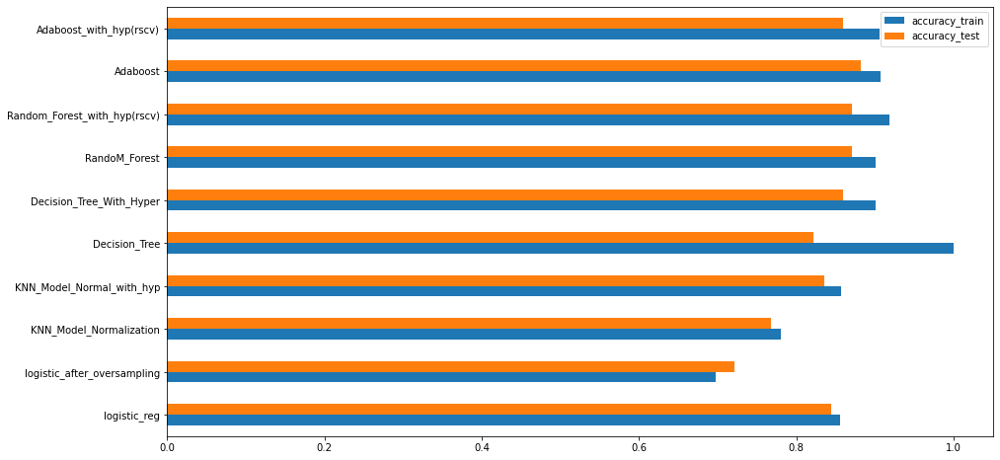

In [161]:
Final_Result_df.plot(kind = 'barh',figsize =(15,8))

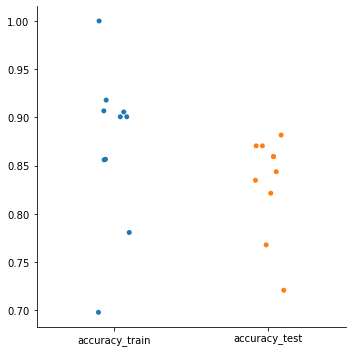

In [162]:
sns.catplot(data=Final_Result_df)

In [163]:
## testing on single row
df.head(3).T

,0,1,2
ID,5524.0,2174.0,4141.0
Year_Birth,1957.0,1954.0,1965.0
Income,58138.0,46344.0,71613.0
Kidhome,0.0,1.0,0.0
Teenhome,0.0,1.0,0.0
Recency,58.0,38.0,26.0
MntWines,635.0,11.0,426.0
MntFruits,88.0,1.0,49.0
MntMeatProducts,546.0,6.0,127.0
MntFishProducts,172.0,2.0,111.0


In [164]:
df.columns

Index(['ID', 'Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5',
       'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Z_CostContact',
       'Z_Revenue', 'Response', 'Marital_Status_Alone',
       'Marital_Status_Divorced', 'Marital_Status_Married',
       'Marital_Status_Single', 'Marital_Status_Together',
       'Marital_Status_Widow', 'Marital_Status_YOLO', 'Education_Basic',
       'Education_Graduation', 'Education_Master', 'Education_PhD'],
      dtype='object')

In [168]:
ID=1
Year_Birth=2000
Income=200
Kidhome=13
Teenhome=67
Recency=98
MntWines=90
MntFruits=799
MntMeatProducts=67
MntFishProducts=40
MntSweetProducts=34
MntGoldProds=9000
NumDealsPurchases=98
NumWebPurchases=25
NumCatalogPurchases=79
NumStorePurchases=30
NumWebVisitsMonth=10
AcceptedCmp3=1
AcceptedCmp4=3
AcceptedCmp5=5
AcceptedCmp1=8
AcceptedCmp2=9
Complain=987
Z_CostContact=67
Z_Revenue=45
Response=1
Marital_Status_Alone=90
Marital_Status_Divorced=78
Marital_Status_Married=34
Marital_Status_Single=23
Marital_Status_Together=87
Marital_Status_Widow=12
Marital_Status_YOLO=21
Education_Basic=13
Education_Graduation=23
Education_Master=56
Education_PhD=90

In [180]:
arr=np.zeros(37)

In [181]:
arr[0]=ID
arr[1]=Year_Birth
arr[2]=Income
arr[3]=Kidhome
arr[4]=Teenhome
arr[5]=Recency
arr[6]=MntWines
arr[7]=MntFruits
arr[8]=MntMeatProducts
arr[9]=MntFishProducts
arr[10]=MntSweetProducts
arr[11]=MntGoldProds
arr[12]=NumDealsPurchases
arr[13]=NumWebPurchases
arr[14]=NumCatalogPurchases
arr[15]=NumStorePurchases
arr[16]=NumWebVisitsMonth
arr[17]=AcceptedCmp3
arr[18]=AcceptedCmp4
arr[19]=AcceptedCmp5
arr[20]=AcceptedCmp1
arr[21]=AcceptedCmp2
arr[22]=Complain
arr[22]=Z_CostContact
arr[24]=Z_Revenue
arr[25]=Response
arr[26]=Marital_Status_Alone
arr[27]=Marital_Status_Divorced
arr[28]=Marital_Status_Married
arr[29]=Marital_Status_Single
arr[30]=Marital_Status_Together
arr[31]=Marital_Status_Widow
arr[32]=Marital_Status_YOLO
arr[33]=Education_Basic
arr[34]=Education_Graduation
arr[35]=Education_Master
arr[36]=Education_PhD

In [178]:
pred =model.predict([arr])
if pred[0]==1:
    print('Customer is purchase')
else:
    print('Customer is not purchase')

Customer is purchase


In [179]:
pred

array([1], dtype=int64)

# >>Create a Pickle File

In [186]:
import pickle as pkl

In [188]:
with open('model.pkl', 'wb') as f:
    pkl.dump(model, f)

In [189]:
with open('StandardScaler.pkl','wb') as f:
    pkl.dump(StandardScaler , f)

In [190]:
with open('MinMaxScaler.pkl','wb') as f:
    pkl.dump(MinMaxScaler , f)